In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
base_path = "C:\\Users\\ACER\\Desktop\\UTC\\SY09\\PROJET\\sy09_russian-troll-tweets"

In [2]:
p = 0.4
original_data=pd.read_csv(os.path.join(base_path, "Data\combined_csv.csv"), skiprows=lambda i: i>0 and random.random() > p)
suppl_data=pd.read_csv(os.path.join(base_path, "Data\data_with_scores\data_with_scores.csv"))
dataset = pd.merge(original_data, suppl_data, left_index=True, right_index=True, how='inner')#, left_on='word', right_on='tweet_words')
selected_cat = ['HashtagGamer', 'LeftTroll', 'NewsFeed', 'RightTroll']
dataset = dataset.loc[original_data["account_category"].isin(selected_cat)]

C:\Users\ACER\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (0,10,15,20) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [41]:
X_variables = ["score_word_HashtagGamer", "score_hashtag_HashtagGamer", "score_word_LeftTroll", "score_hashtag_LeftTroll", "score_word_NewsFeed", "score_hashtag_NewsFeed", "score_word_RightTroll", "score_hashtag_RightTroll"]
y_variables = ["account_category"]
X_dataset = dataset[X_variables]
y_dataset = dataset[y_variables]
X_train, X_test, y_train, y_test = train_test_split(X_dataset, y_dataset, test_size=0.33, random_state=1)

##  Without PCA

<AxesSubplot:xlabel='following', ylabel='followers'>

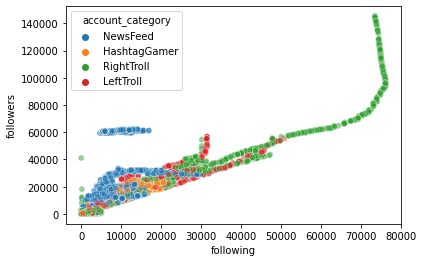

In [40]:
X_train_plot = X_train.copy()
X_train_plot["account_category"] = y_train["account_category"].values
sns.scatterplot(data=X_train_plot[:100000], x="following", y="followers", hue="account_category", alpha=0.5)
# add_decision_boundary(clf_pca) #color=colors.pop(), region=False)

In [21]:
# model training and prediction
clf = QuadraticDiscriminantAnalysis()
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
accuracy_score(y_test, y_pred)

C:\Users\ACER\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


0.4419107384806593

In [43]:
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_train, y_train)
y_pred = neigh.predict(X_test)
accuracy_score(y_test, y_pred)

C:\Users\ACER\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\neighbors\_classification.py:179: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


0.2837257159156895

## With PCA

In [23]:
# avec une PCA

pca = PCA(n_components=2)
pca.fit(X_train)
print(pca.explained_variance_ratio_)
p_compo = pca.transform(X_train)

[0.93045068 0.06954932]


<AxesSubplot:xlabel='PC1', ylabel='PC2'>

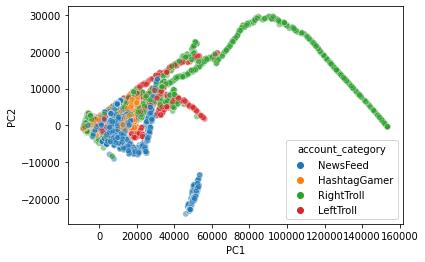

In [25]:
# 2D plotting
p_compo_plot = pd.DataFrame(p_compo, columns = ['PC1','PC2'])
p_compo_plot["account_category"] = y_train["account_category"].values
p_compo_plot

sns.scatterplot(data=p_compo_plot[:100000], x="PC1", y="PC2", hue="account_category", alpha=0.5)

In [26]:
clf_pca = QuadraticDiscriminantAnalysis()
clf_pca.fit(p_compo, y_train)
X_test_pca = pca.transform(X_test)
y_pred = clf_pca.predict(X_test_pca)
accuracy_score(y_test, y_pred)

C:\Users\ACER\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


0.4419107384806593

In [27]:
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(p_compo, y_train)
X_test_pca = pca.transform(X_test)
y_pred = neigh.predict(X_test_pca)
accuracy_score(y_test, y_pred)

C:\Users\ACER\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\neighbors\_classification.py:179: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


0.9828282107965485